## Marine Species Image Classifier (Part 1 Train)
### One-Time Set Up

In [1]:
#install
!pip install tensorflow
!pip install kaggle

### Importing Libraries

In [2]:
#Common Imports
import os
import numpy as np
import zipfile
import random
import shutil
import tensorflow as tf
from tensorflow import keras
from typing import Tuple, List
from shutil import copyfile

2024-08-28 00:18:50.297277: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-28 00:18:50.302025: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-28 00:18:50.316273: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-28 00:18:50.340174: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-28 00:18:50.347046: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-28 00:18:50.365188: I tensorflow/core/platform/cpu_feature_gu

In [3]:
#Data Imports
import pandas as pd
from tqdm import tqdm
from glob import glob
from tensorflow import data as tfd
from tensorflow import image as tfi

In [4]:
#Data Visualization
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import clear_output as cls
import PIL

In [5]:
#Model Architecture
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import Sequential
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import Xception
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import GlobalAveragePooling2D, Dropout, Dense

In [6]:
# Model Training
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report

In [7]:
# Constants
IMAGE_SIZE = 160 # size of the input image
BATCH_SIZE = 32 # number of samples per gradient update
EPOCHS = 50 # number of epochs to train the model
NUM_CLASSES = 9 # number of classes at the dataset
SPLIT_SIZE = .9 # Define proportion of images used for training


# Model training
LOSS = 'sparse_categorical_crossentropy'
METRICS = ['accuracy']

# Hyperparameters
LEARNING_RATE = 1e-3 # learning rate for the optimizer

# Random Seed
RANDOM_SEED = 42 # set random seed for reproducibility
tf.random.set_seed(RANDOM_SEED) # set random seed for TensorFlow
np.random.seed(RANDOM_SEED) # set random seed for NumPy

### Load Data

In [8]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets download "mikoajfish99/marine-animal-images"

mkdir: cannot create directory ‘/home/jupyter/.kaggle’: File exists
cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/home/jupyter/.kaggle/kaggle.json': No such file or directory
Dataset URL: https://www.kaggle.com/datasets/mikoajfish99/marine-animal-images
License(s): CC0-1.0
marine-animal-images.zip: Skipping, found more recently modified local copy (use --force to force download)


In [9]:
! ls 

BestXception.keras			     images
MarineSpeciesMLImageClassifier-Bucket.ipynb  marine-animal-images.zip
MarineSpeciesMLImageClassifier.ipynb	     notebook_template.ipynb
XceptionBaseline.keras			     tmp
XceptionSearch


In [10]:
# # Extract the archive

import zipfile
Original_dir = './tmp/'

try : 
     #os.mkdir(Original_dir)
     local_zip = 'marine-animal-images.zip'
     zip_ref = zipfile.ZipFile(local_zip, 'r')
     zip_ref.extractall(Original_dir)
     zip_ref.close()
except:
     print("Error") 

ORIGINAL_TRAIN_DIR= f"{Original_dir}images/train/"
ORIGINAL_TEST_DIR= f"{Original_dir}images/test/"

In [11]:
#Load Data

ORIGINAL_TRAIN_DIR = "./tmp/images/train/"
ORIGINAL_TEST_DIR = "./tmp/images/test/"

In [12]:
# Specify the directory paths for the data (train , test , validate)
# Define root directory
root_dir = './images/'
TRAINING_DIR =f"{root_dir}train/"  # path to the directory containing train  data
VALIDATION_DIR = f"{root_dir}valid/" # path to the directory containing validation data
TEST_DIR = f"{root_dir}test/" # path to the directory containing test data

try:
    os.mkdir(root_dir)
    os.mkdir(TRAINING_DIR)
    os.mkdir(VALIDATION_DIR)
    os.mkdir(TEST_DIR)
except FileExistsError:
    print("Dir Already Exists")


Dir Already Exists


### Explore Data

In [13]:
def CheckDataInfo(TRAIN_DIR, TEST_DIR):
  # Check the class names
  class_names = sorted(os.listdir(TRAIN_DIR))
  n_classes = len(class_names)
  global NUM_CLASSES
  NUM_CLASSES = n_classes

  # Show
  print(f"Total number of classes: {n_classes}")
  print(f"Classes: {class_names}")
  print('\n')

  # Check the number of images in each class in the test dataset
  print("Total number of TRAIN imgs :", len ( glob(f"{TRAIN_DIR}/*/*")))
  No_images_per_class = []
  Class_name = []
  for i in os.listdir(TRAIN_DIR):
    Class_name.append(i)
    train_class = os.listdir(os.path.join(TRAIN_DIR,i))
    print('Number of images in {}={}'.format(i,len(train_class)))
    No_images_per_class.append(len(train_class))
  print('\n')


  # Check the number of images in each class in the test dataset
  print("Total number of TEST imgs :", len ( glob(f"{TEST_DIR}/*/*")))



  # visualize the number of images in each class in the training dataset
  VisualizeClassesDistribution (TRAIN_DIR,Class_name ,No_images_per_class )

In [14]:
# visualize the number of images in each class in the training dataset
def VisualizeClassesDistribution (Original_Train_DIR ,Class_name ,No_images_per_class ):
  # fig = plt.figure(figsize=(8,3))
  # plt.bar(Class_name, No_images_per_class, color = sns.color_palette("cubehelix",len(Class_name)))
  # fig.tight_layout()
  # fig.suptitle('Classes Distribution at the Train Dataset', fontsize=10)

  # Calculate class distribution
  class_dis = [len(os.listdir(Original_Train_DIR + name)) for name in Class_name]

  # Visualize using interactive pie chart
  pie_chart = px.pie(values=class_dis, names=Class_name, color=Class_name)
  pie_chart.update_layout({'title':{'text':"Class Distribution"}})
  pie_chart.show()

  # Visualize using interactive bar chart
  bar_chart = px.bar(y=class_dis, x=Class_name, color=Class_name)
  bar_chart.show()

Total number of classes: 9
Classes: ['Fish', 'Goldfish', 'Harbor seal', 'Jellyfish', 'Lobster', 'Oyster', 'Sea turtle', 'Squid', 'Starfish']


Total number of TRAIN imgs : 621
Number of images in Sea turtle=82
Number of images in Fish=89
Number of images in Goldfish=65
Number of images in Lobster=39
Number of images in Squid=49
Number of images in Jellyfish=85
Number of images in Starfish=104
Number of images in Harbor seal=46
Number of images in Oyster=62


Total number of TEST imgs : 187


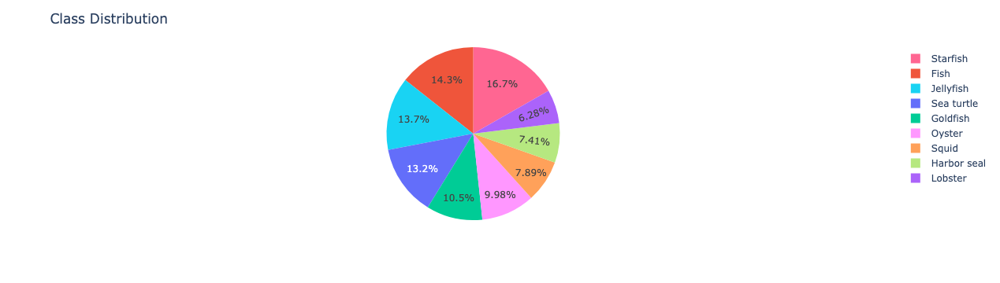

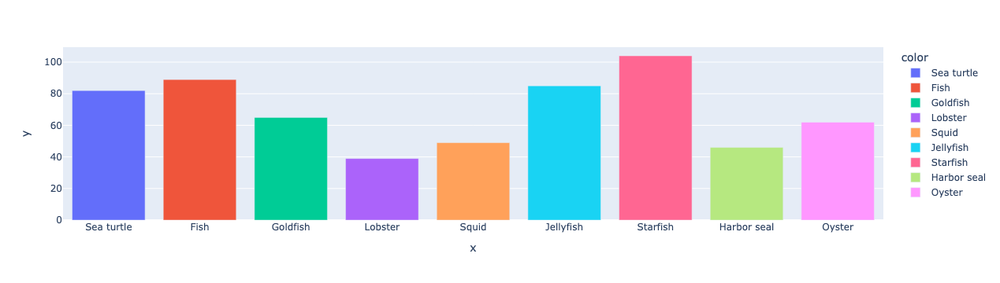

In [15]:
CheckDataInfo(ORIGINAL_TRAIN_DIR , ORIGINAL_TEST_DIR )

In [16]:
def ImgVisulalization (TRAIN_DIR , NUM_CLASSES):
  # Visualize the images in the dataset
  fig, axs = plt.subplots(NUM_CLASSES, 3, figsize = (50,50))
  count = 0
  # for every class in the dataset
  for i in os.listdir(TRAIN_DIR):
    # get the list of all images that belong to a particular class
    train_class = os.listdir(os.path.join(TRAIN_DIR, i))
    
    # plot 3 images per class
    for j in range(3):
      img = os.path.join(TRAIN_DIR, i, train_class[j])
      axs[count][j].set_title (i , fontsize=33)
      axs[count][j].imshow(PIL.Image.open(img))  
    count += 1

  fig.tight_layout()

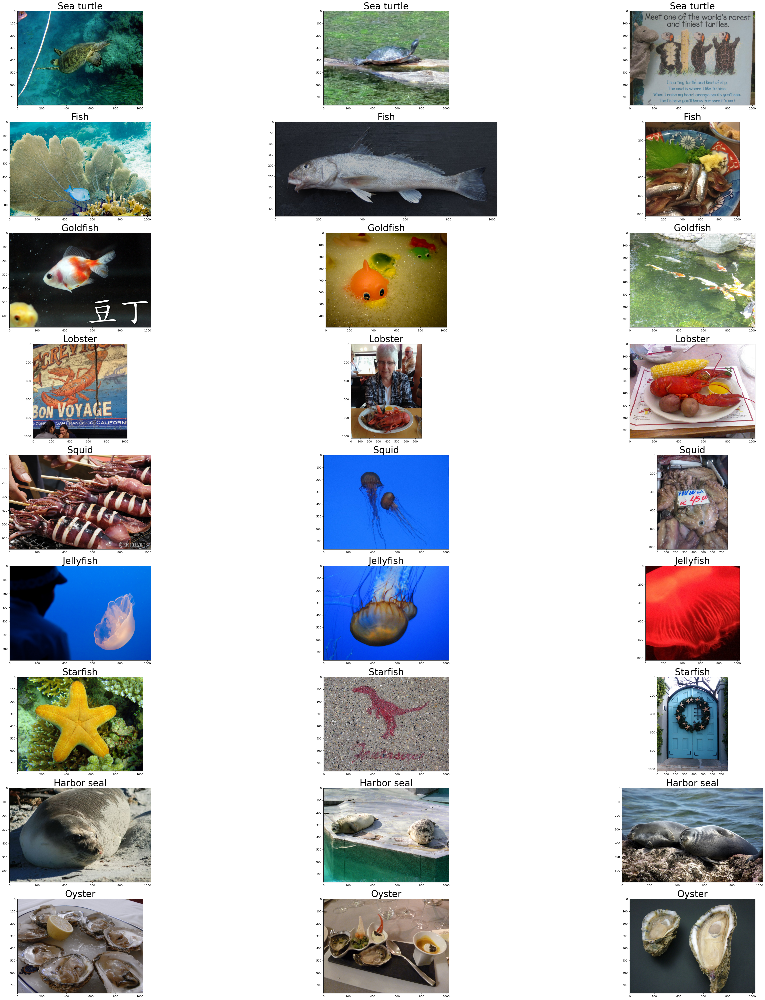

In [17]:
ImgVisulalization (ORIGINAL_TRAIN_DIR , NUM_CLASSES)

### Split Data

In [18]:
#  create_train_val_dirs
def create_train_val_dirs(root_path):

  os.mkdir(root_path)
  os.mkdir(root_path+'/train')
  os.mkdir(root_path+'/val')
  os.mkdir(root_path+'/train/Fish')
  os.mkdir(root_path+'/train/Goldfish')
  os.mkdir(root_path+'/train/Harbor seal')
  os.mkdir(root_path+'/train/Jellyfish')  
  os.mkdir(root_path+'/train/Lobster')
  os.mkdir(root_path+'/train/Oyster') 
  os.mkdir(root_path+'/train/Sea turtle')
  os.mkdir(root_path+'/train/Squid')
  os.mkdir(root_path+'/train/Starfish')

  os.mkdir(root_path+'/val/Fish')
  os.mkdir(root_path+'/val/Goldfish')
  os.mkdir(root_path+'/val/Harbor seal')
  os.mkdir(root_path+'/val/Jellyfish')  
  os.mkdir(root_path+'/val/Lobster')
  os.mkdir(root_path+'/val/Oyster') 
  os.mkdir(root_path+'/val/Sea turtle')
  os.mkdir(root_path+'/val/Squid')
  os.mkdir(root_path+'/val/Starfish') 

In [19]:
#Call create_train_val_dirs

# Empty directory to prevent FileExistsError is the function is run several times
if os.path.exists(root_dir):
  shutil.rmtree(root_dir)
try:
    create_train_val_dirs(root_path=root_dir)
except FileExistsError:
    print("Error")

In [20]:
# Test your create_train_val_dirs function
for rootdir, dirs, files in os.walk(root_dir):
    for subdir in dirs:
        print(os.path.join(rootdir, subdir))

./images/val
./images/train
./images/val/Sea turtle
./images/val/Fish
./images/val/Goldfish
./images/val/Lobster
./images/val/Squid
./images/val/Jellyfish
./images/val/Starfish
./images/val/Harbor seal
./images/val/Oyster
./images/train/Sea turtle
./images/train/Fish
./images/train/Goldfish
./images/train/Lobster
./images/train/Squid
./images/train/Jellyfish
./images/train/Starfish
./images/train/Harbor seal
./images/train/Oyster


In [21]:
# split_data
def split_data(SOURCE_DIR, TRAINING_DIR, VALIDATION_DIR, SPLIT_SIZE):
    """
    Splits the data into train and test sets
  
    Args:
        SOURCE_DIR (string): directory path containing the images
        TRAINING_DIR (string): directory path to be used for training
        VALIDATION_DIR (string): directory path to be used for validation
        SPLIT_SIZE (float): proportion of the dataset to be used for training
    
    Returns:
        None
    """

    files = []
    for filename in os.listdir(SOURCE_DIR):
        file = SOURCE_DIR + filename
        if os.path.getsize(file) > 0:
            files.append(filename)
        else:
            print(filename + " is zero length, so ignoring.")

    training_length = int(len(files) * SPLIT_SIZE)
    testing_length = int(len(files) - training_length)
    shuffled_set = random.sample(files, len(files))
    training_set = shuffled_set[0:training_length]
    testing_set = shuffled_set[-testing_length:]

    for filename in training_set:
        this_file = SOURCE_DIR + filename
        destination = TRAINING_DIR + filename
        copyfile(this_file, destination)
    
    for filename in testing_set:
        this_file = SOURCE_DIR + filename
        destination = VALIDATION_DIR + filename
        copyfile(this_file, destination)

In [22]:
# Test your split_data function
# Define paths


Fish_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Fish/"
Goldfish_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Goldfish/"
Harbor_seal_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Harbor seal/"
Jellyfish_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Jellyfish/"
Lobster_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Lobster/"
Oyster_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Oyster/"
Sea_turtle_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Sea turtle/"
Squid_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Squid/"
Starfish_SOURCE_DIR = f"{ORIGINAL_TRAIN_DIR}Starfish/"


TRAINING_DIR = "images/train/"
VALIDATION_DIR = "images/val/"
TRAINING_Fish_DIR = os.path.join(TRAINING_DIR, "Fish/")
VALIDATION_Fish_DIR = os.path.join(VALIDATION_DIR, "Fish/")
TRAINING_Goldfish_DIR = os.path.join(TRAINING_DIR, "Goldfish/")
VALIDATION_Goldfish_DIR = os.path.join(VALIDATION_DIR, "Goldfish/")
TRAINING_Harbor_seal_DIR = os.path.join(TRAINING_DIR, "Harbor seal/")
VALIDATION_Harbor_seal_DIR = os.path.join(VALIDATION_DIR, "Harbor seal/")
TRAINING_Jellyfish_DIR = os.path.join(TRAINING_DIR, "Jellyfish/")
VALIDATION_Jellyfish_DIR = os.path.join(VALIDATION_DIR, "Jellyfish/")
TRAINING_Lobster_DIR = os.path.join(TRAINING_DIR, "Lobster/")
VALIDATION_Lobster_DIR = os.path.join(VALIDATION_DIR, "Lobster/")
TRAINING_Oyster_DIR = os.path.join(TRAINING_DIR, "Oyster/")
VALIDATION_Oyster_DIR = os.path.join(VALIDATION_DIR, "Oyster/")
TRAINING_Sea_turtle_DIR = os.path.join(TRAINING_DIR, "Sea turtle/")
VALIDATION_Sea_turtle_DIR = os.path.join(VALIDATION_DIR, "Sea turtle/")
TRAINING_Squid_DIR = os.path.join(TRAINING_DIR, "Squid/")
VALIDATION_Squid_DIR = os.path.join(VALIDATION_DIR, "Squid/")
TRAINING_Starfish_DIR = os.path.join(TRAINING_DIR, "Starfish/")
VALIDATION_Starfish_DIR = os.path.join(VALIDATION_DIR, "Starfish/")

# Empty directories in case you run this cell multiple times

if len(os.listdir(TRAINING_Fish_DIR)) > 0:
    for file in os.scandir(TRAINING_Fish_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Goldfish_DIR)) > 0:
    for file in os.scandir(TRAINING_Goldfish_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Harbor_seal_DIR)) > 0:
    for file in os.scandir(TRAINING_Harbor_seal_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Jellyfish_DIR)) > 0:
    for file in os.scandir(TRAINING_Jellyfish_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Lobster_DIR)) > 0:
    for file in os.scandir(TRAINING_Lobster_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Oyster_DIR)) > 0:
    for file in os.scandir(TRAINING_Oyster_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Sea_turtle_DIR)) > 0:
    for file in os.scandir(TRAINING_Sea_turtle_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Squid_DIR)) > 0:
    for file in os.scandir(TRAINING_Squid_DIR):
        os.remove(file.path)
if len(os.listdir(TRAINING_Starfish_DIR)) > 0:
    for file in os.scandir(TRAINING_Starfish_DIR):
        os.remove(file.path)

# Validation Dirs

if len(os.listdir(VALIDATION_Fish_DIR)) > 0:
    for file in os.scandir(VALIDATION_Fish_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Goldfish_DIR)) > 0:
    for file in os.scandir(VALIDATION_Goldfish_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Harbor_seal_DIR)) > 0:
    for file in os.scandir(VALIDATION_Harbor_seal_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Jellyfish_DIR)) > 0:
    for file in os.scandir(VALIDATION_Jellyfish_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Lobster_DIR)) > 0:
    for file in os.scandir(VALIDATION_Lobster_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Oyster_DIR)) > 0:
    for file in os.scandir(VALIDATION_Oyster_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Sea_turtle_DIR)) > 0:
    for file in os.scandir(VALIDATION_Sea_turtle_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Squid_DIR)) > 0:
    for file in os.scandir(VALIDATION_Squid_DIR):
        os.remove(file.path)
if len(os.listdir(VALIDATION_Starfish_DIR)) > 0:
    for file in os.scandir(VALIDATION_Starfish_DIR):
        os.remove(file.path)



# Run the function
split_data(Fish_SOURCE_DIR, TRAINING_Fish_DIR, VALIDATION_Fish_DIR, SPLIT_SIZE)
split_data(Goldfish_SOURCE_DIR , TRAINING_Goldfish_DIR, VALIDATION_Goldfish_DIR, SPLIT_SIZE)
split_data(Harbor_seal_SOURCE_DIR , TRAINING_Harbor_seal_DIR , VALIDATION_Harbor_seal_DIR, SPLIT_SIZE)
split_data(Jellyfish_SOURCE_DIR, TRAINING_Jellyfish_DIR, VALIDATION_Jellyfish_DIR, SPLIT_SIZE)
split_data(Lobster_SOURCE_DIR, TRAINING_Lobster_DIR, VALIDATION_Lobster_DIR, SPLIT_SIZE)
split_data(Oyster_SOURCE_DIR, TRAINING_Oyster_DIR, VALIDATION_Oyster_DIR, SPLIT_SIZE)
split_data(Sea_turtle_SOURCE_DIR, TRAINING_Sea_turtle_DIR, VALIDATION_Sea_turtle_DIR, SPLIT_SIZE)
split_data(Squid_SOURCE_DIR, TRAINING_Squid_DIR, VALIDATION_Squid_DIR, SPLIT_SIZE)
split_data(Starfish_SOURCE_DIR, TRAINING_Starfish_DIR, VALIDATION_Starfish_DIR, SPLIT_SIZE)



# Check that the number of images matches the expected output
# function should perform copies rather than moving images so original directories should contain unchanged images

# Training and validation splits
print(f"Original Fish's directory has {len(os.listdir(Fish_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Fish_DIR))} images of Fish for training")
print(f"There are {len(os.listdir(VALIDATION_Fish_DIR))} images of Fish for validation")
print('\n\n')

print(f"Original Goldfish's directory has {len(os.listdir(Goldfish_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Goldfish_DIR))} images of Goldfish for training")
print(f"There are {len(os.listdir(VALIDATION_Goldfish_DIR))} images of Goldfish for validation")
print('\n\n')

print(f"Original Harbor seal's directory has {len(os.listdir(Harbor_seal_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Harbor_seal_DIR))} images of Harbor seal for training")
print(f"There are {len(os.listdir(VALIDATION_Harbor_seal_DIR))} images of Harbor seal for validation")
print('\n\n')

print(f"Original Jellyfish's directory has {len(os.listdir(Jellyfish_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Jellyfish_DIR))} images of Jellyfish for training")
print(f"There are {len(os.listdir(VALIDATION_Jellyfish_DIR))} images of Jellyfish for validation")
print('\n\n')

print(f"Original Lobster's directory has {len(os.listdir(Lobster_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Lobster_DIR))} images of Lobster for training")
print(f"There are {len(os.listdir(VALIDATION_Lobster_DIR))} images of Lobster for validation")
print('\n\n')

print(f"Original Oyster's directory has {len(os.listdir(Oyster_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Oyster_DIR))} images of Oyster for training")
print(f"There are {len(os.listdir(VALIDATION_Oyster_DIR))} images of Oyster for validation")
print('\n\n')

print(f"Original Sea turtle's directory has {len(os.listdir(Sea_turtle_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Sea_turtle_DIR))} images of Sea turtle for training")
print(f"There are {len(os.listdir(VALIDATION_Sea_turtle_DIR))} images of Sea turtle for validation")
print('\n\n')

print(f"Original Squid's directory has {len(os.listdir(Squid_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Squid_DIR))} images of Squid for training")
print(f"There are {len(os.listdir(VALIDATION_Squid_DIR))} images of Squid for validation")
print('\n\n')

print(f"Original Starfish's directory has {len(os.listdir(Starfish_SOURCE_DIR))} images")
print(f"There are {len(os.listdir(TRAINING_Starfish_DIR))} images of Starfish for training")
print(f"There are {len(os.listdir(VALIDATION_Starfish_DIR))} images of Starfish for validation")
print('\n\n')

Original Fish's directory has 89 images
There are 80 images of Fish for training
There are 9 images of Fish for validation



Original Goldfish's directory has 65 images
There are 58 images of Goldfish for training
There are 7 images of Goldfish for validation



Original Harbor seal's directory has 46 images
There are 41 images of Harbor seal for training
There are 5 images of Harbor seal for validation



Original Jellyfish's directory has 85 images
There are 76 images of Jellyfish for training
There are 9 images of Jellyfish for validation



Original Lobster's directory has 39 images
There are 35 images of Lobster for training
There are 4 images of Lobster for validation



Original Oyster's directory has 62 images
There are 55 images of Oyster for training
There are 7 images of Oyster for validation



Original Sea turtle's directory has 82 images
There are 73 images of Sea turtle for training
There are 9 images of Sea turtle for validation



Original Squid's directory has 49 ima

### Create Data Generators

In [23]:
#  train_val_generators
def train_val_generators(TRAINING_DIR, VALIDATION_DIR , TEST_DIR):
    """
    Creates the training and validation data generators
  
    Args:
        TRAINING_DIR (string): directory path containing the training images
        VALIDATION_DIR (string): directory path containing the testing/validation images
    
    Returns:
        train_generator, validation_generator - tuple containing the generators
    """

    # Instantiate the ImageDataGenerator class 
    train_datagen = ImageDataGenerator(rescale=1.0/255.) #set the rescale argument

    # Pass in the appropriate arguments to the flow_from_directory method
    train_generator = train_datagen.flow_from_directory(directory=TRAINING_DIR,
                                                     batch_size=BATCH_SIZE,
                                                     class_mode='sparse',
                                                     target_size=(IMAGE_SIZE, IMAGE_SIZE),
                                                     shuffle = True)

    # Instantiate the ImageDataGenerator class 
    validation_datagen = ImageDataGenerator(rescale=1.0/255.) #set the rescale argument

    # Pass in the appropriate arguments to the flow_from_directory method
    validation_generator = validation_datagen.flow_from_directory(VALIDATION_DIR,
                                                              batch_size=BATCH_SIZE,
                                                              class_mode='sparse',
                                                              target_size=(IMAGE_SIZE, IMAGE_SIZE),
                                                              shuffle = True)

    # Instantiate the ImageDataGenerator class  , For test datagenerator, we only normalize the data.
    test_datagen = ImageDataGenerator(rescale=1./255.)
    
    # Pass in the appropriate arguments to the flow_from_directory method
    test_generator = test_datagen.flow_from_directory(
        TEST_DIR,
        target_size=(IMAGE_SIZE, IMAGE_SIZE),
        batch_size=BATCH_SIZE,
        class_mode='sparse')

    return train_generator, validation_generator , test_generator

In [24]:
# Test your generators
train_generator, validation_generator , test_generator = train_val_generators(TRAINING_DIR, VALIDATION_DIR, ORIGINAL_TEST_DIR)

Found 555 images belonging to 9 classes.
Found 66 images belonging to 9 classes.
Found 186 images belonging to 9 classes.


## Neural Network (Backbone) Analysis

In [25]:
# Name all the backbones
backbone_names = [
    'ResNet50V2',
    'ResNet152V2',
    'InceptionV3',
    'Xception',
    'MobileNetV2'
]

# Load all the backbones
backbones = [
    ResNet50V2(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    ResNet152V2(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    InceptionV3(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    Xception(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    MobileNetV2(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
]

# Freeze the weights of all the backbones
for backbone in backbones:
    backbone.trainable = False

In [ ]:
# Record the learing curve for all the backbones
HISTORIES = {}

# Loop over all the backbones
for name, backbone in zip(backbone_names, backbones):
    
    # Show
    print(f"Training: {name}\n")
    
    # Make a small model
    model = Sequential([
        backbone,
        GlobalAveragePooling2D(),
        Dropout(0.5),
        Dense(NUM_CLASSES, activation='softmax')
    ])
    
    # Compile the model
    model.compile(
        loss=LOSS,
        optimizer=Adam(LEARNING_RATE),
        metrics=METRICS
    )
    
    # Train the model
    model_history = model.fit(
        train_generator,
        validation_data= validation_generator,
        epochs=15,
        batch_size=BATCH_SIZE,
        verbose = 2, 
    )
    
    # Store the history
    HISTORIES[name] = model_history.history
    cls()

Training: MobileNetV2

Epoch 1/15
18/18 - 16s - 869ms/step - accuracy: 0.1784 - loss: 2.6023 - val_accuracy: 0.4394 - val_loss: 1.5694
Epoch 2/15
18/18 - 8s - 467ms/step - accuracy: 0.4667 - loss: 1.6523 - val_accuracy: 0.6212 - val_loss: 1.1156
Epoch 3/15
18/18 - 10s - 571ms/step - accuracy: 0.5838 - loss: 1.2490 - val_accuracy: 0.7576 - val_loss: 0.8928
Epoch 4/15
18/18 - 9s - 479ms/step - accuracy: 0.6486 - loss: 1.0132 - val_accuracy: 0.7576 - val_loss: 0.7846
Epoch 5/15
18/18 - 9s - 478ms/step - accuracy: 0.7171 - loss: 0.8269 - val_accuracy: 0.7879 - val_loss: 0.7307
Epoch 6/15
18/18 - 8s - 472ms/step - accuracy: 0.7568 - loss: 0.7100 - val_accuracy: 0.8182 - val_loss: 0.7262
Epoch 7/15
18/18 - 11s - 613ms/step - accuracy: 0.7910 - loss: 0.6370 - val_accuracy: 0.7879 - val_loss: 0.6920
Epoch 8/15
18/18 - 9s - 479ms/step - accuracy: 0.7838 - loss: 0.6144 - val_accuracy: 0.7879 - val_loss: 0.6825
Epoch 9/15
18/18 - 8s - 467ms/step - accuracy: 0.8036 - loss: 0.5639 - val_accuracy: 0

In [ ]:
# Loop over the model training curves
for name, history in HISTORIES.items():
    
    # Create a new figure for each backbone
    plt.figure(figsize=(20,5))
    
    # Plot the loss curve in the first subplot
    plt.subplot(1, 2, 1)
    plt.title(f"{name} - Loss Curve")
    plt.plot(history['loss'], label="Training Loss")
    plt.plot(history['val_loss'], label="Validation Loss")
    
    # Plot a vertical line at epoch 9 and annotate the difference between the validation loss and the training loss
    plt.plot([9, 9],[min(history['loss']), min(history['val_loss'])], linestyle='--', marker="*", color='k', alpha=0.7)
    plt.text(x=9.1, y=np.mean([min(history['loss']), min(history['val_loss'])]), s=str(np.round(min(history['val_loss']) - min(history['loss']),3)), fontsize=15, color='b')
    
    # Plot a horizontal line at epoch 9 and annotate the values for the validation loss and training loss.
    plt.axhline(min(history['loss']), color='g', linestyle="--", alpha=0.5)
    
    # Set the x- and y-labels, and the x- and y-limits
    plt.xlabel("Epochs")
    plt.ylabel("Cross Entropy Loss")
    plt.ylim([0.2, 0.8])
    plt.xlim([5, 10])
    
    # Show the legend and grid
    plt.legend()
    plt.grid()
    
    # Plot the accuracy curve in the second subplot
    plt.subplot(1, 2, 2)
    plt.title(f"{name} - Accuracy Curve")
    plt.plot(history['accuracy'], label="Training Accuracy")
    plt.plot(history['val_accuracy'], label="Validation Accuracy")
    
    # Plot a vertical line at epoch 9 and annotate the difference between the validation accuracy and the training accuracy
    plt.plot([9, 9],[max(history['accuracy']), max(history['val_accuracy'])], linestyle='--', marker="*", color='k', alpha=0.7)
    plt.text(x=9.1, y=np.mean([max(history['accuracy']), max(history['val_accuracy'])]), s=str(np.round(max(history['accuracy']) - max(history['val_accuracy']),3)), fontsize=15, color='b')
    
    # Set the x- and y-labels, and the x- and y-limits
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.ylim([0.7,0.9])
    plt.xlim([5, 10])
    
    # Show the legend and grid
    plt.legend()
    plt.grid()
    
    # Show the plot
    plt.show()

In [ ]:
# Xception Backbone
print("Loading Xception Backbone: ")
xception = Xception(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), weights='imagenet', include_top=False)

# Freeze the model weights
xception.trainable = False

# The Mobilenet Model baseline
xception = Sequential([
    xception,
    GlobalAveragePooling2D(),
    Dropout(0.5),
    Dense(NUM_CLASSES, activation='softmax')
])

# Compile the Baseline
xception.compile(
    loss=LOSS,
    optimizer=Adam(learning_rate=LEARNING_RATE),
    metrics=METRICS
)

# Train the Xception Baseline Model
print("\nTraining Baseline Model: ")
xception.fit(
   train_generator,
   validation_data= validation_generator, 
   epochs=EPOCHS , 
   callbacks=[
#         EarlyStopping(patience=3, restore_best_weights=True),
        ModelCheckpoint("XceptionBaseline.keras", save_best_only=True)
    ],
    batch_size=BATCH_SIZE
)


In [ ]:
# # Testing Evaluation
xception_test_loss, xception_test_acc = xception.evaluate(test_generator, verbose =1)


print(f"\nXception Baseline Testing Loss     : {xception_test_loss}.")
print(f"Xception Baseline Testing Accuracy : {xception_test_acc}.")

In [ ]:
def build_model(hp):
    
    # Define all hyperparms
    xception = Xception(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), weights='imagenet', include_top=False)
    xception.trainable = False
    n_layers = hp.Choice('n_layers', [2, 4])
    dropout_rate = hp.Choice('rate', [0.4, 0.7])
    n_units = hp.Choice('units', [256, 512])
    learning_rate = hp.Choice('lr', [LEARNING_RATE, LEARNING_RATE * 0.1, LEARNING_RATE*0.01])
    
    # Mode architecture
    model = Sequential([
        xception,
        GlobalAveragePooling2D(),
    ])
    
    # Add hidden/top layers 
    for _ in range(n_layers):
        model.add(Dense(n_units, activation='relu', kernel_initializer='he_normal'))
    
    # Add Dropout Layer
    model.add(Dropout(dropout_rate))
    
    # Output Layer
    model.add(Dense(NUM_CLASSES, activation='softmax'))
    
    # Compile the model
    model.compile(
        loss=LOSS,
        optimizer = Adam(learning_rate),
        metrics = METRICS
    )
    # Return model
    return model

In [ ]:
# Model Hypertunning
!pip install -q keras_tuner
cls()
import keras_tuner as kt

In [ ]:
# Initialize Random Searcher
random_searcher = kt.RandomSearch(
    hypermodel=build_model, 
    objective='val_loss', 
    max_trials=10, 
    seed=42, 
    project_name="XceptionSearch", 
    loss=LOSS)

# Start Searching
search = random_searcher.search(
    train_generator,
    validation_data= validation_generator, 
    epochs = 10,
    batch_size = BATCH_SIZE
)

In [ ]:
# Best Hyper params
best_hps = random_searcher.get_best_hyperparameters()[0]
print(f"Best Hyper Params founded: {best_hps.values}\n")

# Build the best model
xception_model = build_model(best_hps)
xception_model.summary()

# Compile the model
print("\nTraining Best Model Architecture : ")
xception_model_history = xception_model.fit(
    train_generator,
    validation_data= validation_generator, 
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    callbacks=[
        EarlyStopping(patience=3, restore_best_weights=True),
        ModelCheckpoint('BestXception.keras', save_best_only=True)
    ]
)

In [ ]:
test_loss, test_acc = xception_model.evaluate(test_generator)
print("Test Loss    : {:.4} | Baseline : {:.4}".format(test_loss, xception_test_loss))
print("Test Accuracy: {:.4}% | Baseline : {:.4}%".format(test_acc*100, xception_test_acc*100))

In [ ]:
# Collect the history of the training run
xception_model_history = pd.DataFrame(xception_model_history.history)

# Create a figure to display the model's performance
plt.figure(figsize=(20, 5))

# Plot the loss curve in the first subplot
plt.subplot(1, 2, 1)
plt.title("xception - Loss Curve")
plt.plot(xception_model_history['loss'], label="Training Loss")
plt.plot(xception_model_history['val_loss'], label="Validation Loss")

# Horizontal line to show the testing performance
plt.axhline(y=test_loss, label="Test Loss", linestyle='--', color='green')

# Set the x- and y-labels, and the x- and y-limits
plt.xlabel("Epochs")
plt.ylabel("Cross Entropy Loss")
plt.ylim([0, 0.4])

# Show the legend and grid
plt.legend()
plt.grid()

# Plot the accuracy curve in the second subplot
plt.subplot(1, 2, 2)
plt.title("xception - Accuracy Curve")
plt.plot(xception_model_history['accuracy'], label="Training Accuracy")
plt.plot(xception_model_history['val_accuracy'], label="Validation Accuracy")

# Horizontal line to show the testing performance
plt.axhline(y=test_acc, label="Test Accuracy", linestyle='--', color='green')

# Set the x- and y-labels, and the x- and y-limits
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
# plt.ylim([0.85, 1])
plt.ylim([0, 1])


# Show the legend and grid
plt.legend()
plt.grid()

# Display the plot
plt.show()


In [ ]:
# assigning label names to the corresponding indexes
labels = {0: 'Fish', 1: 'Goldfish', 2: 'Harbor seal', 3:'Jellyfish', 4: 'Lobster', 5:'Oyster',6:'Sea turtle',7:'Squid', 8:'Starfish'}


In [ ]:
# loading images and their predictions 
from google.cloud import storage
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import numpy as np
from PIL import Image
import os

# import cv2

# Initialize GCS client
storage_client = storage.Client()
bucket_name = 'marine-science-image-bucket'  # Replace with your GCS bucket name
bucket = storage_client.get_bucket(bucket_name)

ORIGINAL_TEST_DIR = 'marine-science-image-bucket/images/test/'  # Replace with your test directory path in the bucket
IMAGE_SIZE = 256  # Replace with your desired image size
labels = ['class1', 'class2', 'class3']  # Replace with your actual class labels

prediction = []
original = []
image = []
count = 0

# List blobs in the GCS bucket
blobs = storage_client.list_blobs(bucket_name, prefix=ORIGINAL_TEST_DIR)

for blob in blobs:
    if blob.name.endswith('/'):
        continue  # Skip directories

    # Extract the class name from the blob path
    class_name = os.path.basename(os.path.dirname(blob.name))
    
    # Download the blob to a temporary file
    blob_bytes = blob.download_as_bytes()
    
    # Open the image using PIL
    img = Image.open(io.BytesIO(blob_bytes))
    
    # Resize the image
    img = img.resize((IMAGE_SIZE, IMAGE_SIZE))
    
    # Append image to the image list
    image.append(img)
    
    # Convert image to array
    img = np.asarray(img, dtype=np.float32)
    
    # Normalize the image
    img = img / 255
    
    # Reshape the image into a 4D array
    img = img.reshape(-1, IMAGE_SIZE, IMAGE_SIZE, 3)
    
    # Make prediction using the model
    predict = model.predict(img)
    
    # Get the index corresponding to the highest value in the prediction
    predict = np.argmax(predict)
    
    # Append the predicted class to the list
    prediction.append(labels[predict])
    
    # Append the original class to the list
    original.append(class_name)


In [ ]:
# visualizing the results
import random
fig=plt.figure(figsize = (25,30))
for i in range(20):
    j = random.randint(0,len(image))
    fig.add_subplot(5,4,i+1)
    fig.suptitle('Test Predictions', fontsize=40)
    plt.xlabel("Prediction -" + prediction[j] +"   Original -" + original[j] , fontsize=22)
    plt.imshow(image[j])
fig.tight_layout()

In [ ]:
# plot confusion matrix

plt.figure(figsize=(20,10))

display_labels=['Fish', 'Goldfish', 'HarborSeal', 'Jellyfish', 'Lobster', 'Oyster', 'SeaTurtle', 'Squid', 'Starfish']
cm = confusion_matrix(np.asarray(original), np.asarray(prediction))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax , xticklabels=display_labels, yticklabels=display_labels)

ax.set_xlabel('Predicted')
ax.set_ylabel('Original')
ax.set_title('Confusion_matrix')
